## COVID-19 Analysis

---

In [1]:
# Import libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import plotly.graph_objs as go
from plotly import tools
from plotly.offline import init_notebook_mode, plot, iplot

In [2]:
# Extract latitudes & longitudes of locations

import geopy
from geopy.geocoders import Nominatim
geolocator=Nominatim(user_agent="app")
location = geolocator.geocode("Slovakia")
print(location.latitude)
print(location.longitude)

48.6726975
19.63679421037233


In [3]:
# Import dataset

import ssl
ssl._create_default_https_context = ssl._create_unverified_context

current_data = pd.read_csv('https://raw.githubusercontent.com/datasets/covid-19/master/data/countries-aggregated.csv')
current_data.head()

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0


In [4]:
# Choropleth map of confirmed cases in Europe

fig = px.choropleth(current_data,locations='Country',locationmode='country names',color='Confirmed',animation_frame='Date',scope='europe')
fig.update_layout(title='Choropleth map of confirmed cases in Europe',template="plotly_dark")
fig.show()

In [5]:
# Choropleth map of spread over time

fig = px.scatter_geo(current_data,locations='Country',locationmode='country names',color='Confirmed',size='Confirmed',hover_name="Country",animation_frame='Date',title='Spread over Time')
fig.update(layout_coloraxis_showscale=False,layout_template="plotly_dark")
fig.show()

## Situation in Slovakia

In [6]:
# Create dataframe

df = current_data
df.shape

(84864, 5)

In [7]:
# Group by country

df2 = df.groupby(['Country'])[['Confirmed','Recovered','Deaths']].max().reset_index()
df2.head()

,Country,Confirmed,Recovered,Deaths
0,Afghanistan,56873,51940,2512
1,Albania,127192,95600,2291
2,Algeria,118004,82192,3116
3,Andorra,12363,11616,119
4,Angola,23010,21545,547


In [8]:
# Zoomed in on my homeland

df2[df2['Country']=='Slovakia']

,Country,Confirmed,Recovered,Deaths
156,Slovakia,366894,255300,10243


In [9]:
# Daily updates

df_slovakia = df[df['Country']=='Slovakia']
df_slovakia.tail()

,Date,Country,Confirmed,Recovered,Deaths
69389,2021-04-03,Slovakia,364622,255300,9948
69390,2021-04-04,Slovakia,365242,255300,10025
69391,2021-04-05,Slovakia,365400,255300,10094
69392,2021-04-06,Slovakia,365733,255300,10094
69393,2021-04-07,Slovakia,366894,255300,10243


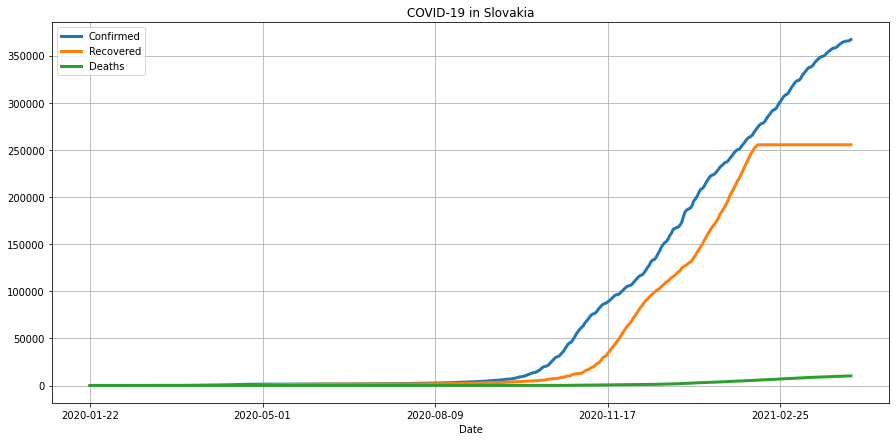

In [10]:
# COVID-19 confirmed, recovered cases with deaths in Slovakia

def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

show_plot(df_slovakia, "COVID-19 in Slovakia")

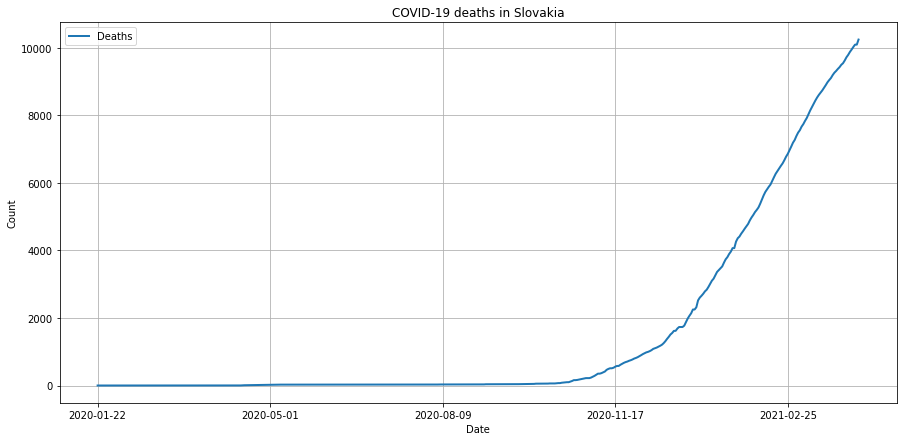

In [11]:
# COVID-19 deaths in Slovakia

df_slovakia.plot(x = 'Date', y = 'Deaths', figsize = (15,7), linewidth = 2);
plt.ylabel('Count')
plt.title('COVID-19 deaths in Slovakia')
plt.legend(loc="upper left")
plt.grid()

## Situation in the US

In [12]:
# Daily updates

df_us = df[df['Country']=='US']
df_us.tail()

,Date,Country,Confirmed,Recovered,Deaths
79113,2021-04-03,US,30672664,0,554913
79114,2021-04-04,US,30707596,0,555196
79115,2021-04-05,US,30785390,0,555711
79116,2021-04-06,US,30847348,0,556546
79117,2021-04-07,US,30921976,0,559109


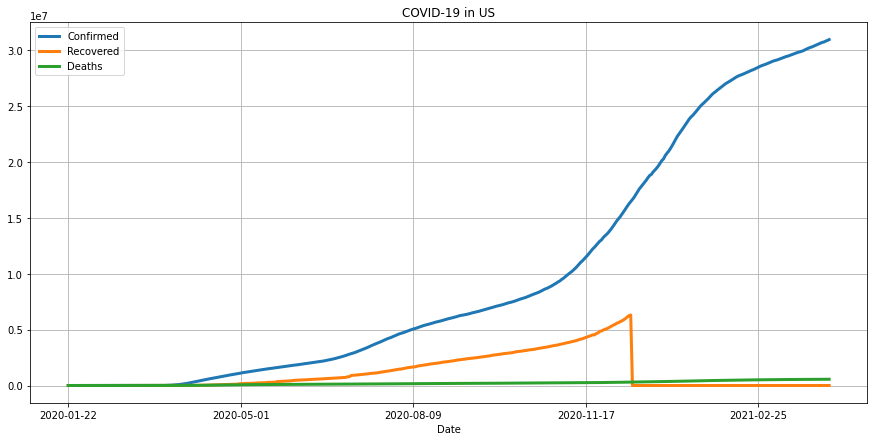

In [13]:
# COVID-19 confirmed, recovered cases with deaths in the US

def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

show_plot(df_us, "COVID-19 in US")

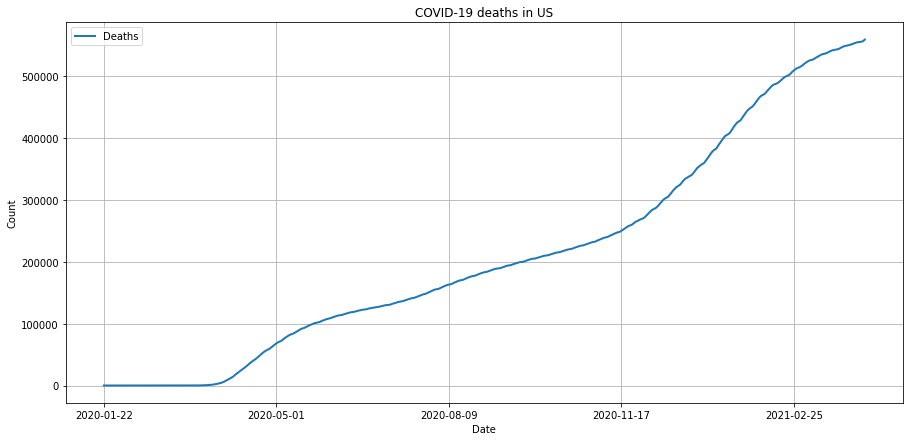

In [14]:
# COVID-19 deaths in the US

df_us.plot(x = 'Date', y = 'Deaths', figsize = (15,7), linewidth = 2);
plt.ylabel('Count')
plt.title('COVID-19 deaths in US')
plt.legend(loc="upper left")
plt.grid()

## Situation around the world

In [15]:
# Identify latitudes & longitudes of locations, append them to new dataframe and drop geo_loc

lat_lon=[]
geolocator=Nominatim(user_agent="app")

for location in df2['Country']:
    location = geolocator.geocode(location)

    if location is None:
        lat_lon.append(np.nan)
    else:    
        geo=(location.latitude,location.longitude)
        lat_lon.append(geo)
        
df2['geo_loc'] = lat_lon
lat,lon = zip(*np.array(df2['geo_loc']))
df2['Latitude']=lat
df2['Longitude']=lon
df2.drop(['geo_loc'],axis=1,inplace=True)
df2.head()

,Country,Confirmed,Recovered,Deaths,Latitude,Longitude
0,Afghanistan,56873,51940,2512,33.768006,66.238514
1,Albania,127192,95600,2291,41.000028,19.999962
2,Algeria,118004,82192,3116,28.000027,2.999983
3,Andorra,12363,11616,119,42.540717,1.573203
4,Angola,23010,21545,547,-11.877577,17.569124


In [16]:
# Plotting a map of current confirmed cases

import folium

current_map = folium.Map(location=[54, 15], tiles='openstreetmap', zoom_start=2)

for idx, row in df2.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Recovered']).add_to(current_map)

current_map

In [17]:
# Plotting a map of current confirmed cases in clusters

current_map = folium.Map(location=[54,15], tiles='cartodbpositron', zoom_start=2)

from folium.plugins import MarkerCluster
mc = MarkerCluster()
for idx, row in df2.iterrows():
    mc.add_child(folium.Marker([row['Latitude'], row['Longitude']],popup=row['Confirmed']))
current_map.add_child(mc)

current_map

In [18]:
# Plotting a map of current confirmed cases with heat map

from folium.plugins import HeatMap

current_map = folium.Map(location=[54,15], zoom_start=2)
HeatMap(data=df2[['Latitude', 'Longitude','Confirmed']], radius=15).add_to(current_map)

current_map

## Worldometer Analysis

In [19]:
# Import dataset

worldometer = pd.read_csv('~/Documents/Github/various-projects/data/worldometer_data.csv')
worldometer.head()

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
0,USA,North America,3.324950e+08,31714336,77093.0,573819.0,971.0,24271394.0,71701.0,6869123.0,9053.0,95383.0,1726.0,415050165.0,1248290.0,Americas
1,Brazil,South America,2.137206e+08,13286324,89293.0,345287.0,4190.0,11732193.0,68035.0,1208844.0,8318.0,62167.0,1616.0,28600000.0,133820.0,Americas
2,India,Asia,1.390420e+09,13057954,131893.0,167694.0,802.0,11910741.0,61836.0,979519.0,8944.0,9391.0,121.0,252677379.0,181727.0,South-EastAsia
3,France,Europe,6.538471e+07,4939258,15869.0,98065.0,345.0,303639.0,2340.0,4537554.0,5729.0,75541.0,1500.0,68007540.0,1040114.0,Europe
4,Russia,Europe,1.459827e+08,4614834,8672.0,101845.0,365.0,4239038.0,9558.0,273951.0,2300.0,31612.0,698.0,122600000.0,839826.0,Europe


In [20]:
# Highlighting maximum values

# worldometer.style.background_gradient(cmap='RdPu')

In [21]:
# Creating function of comparision

def plot(df,x,y,xaxis_label,yaxis_label,title):
    fig = px.bar(worldometer.head(20), y=y,x=x,color='WHO Region')
    fig.update_layout(title=title,xaxis_title=xaxis_label,yaxis_title=yaxis_label)
    fig.show()

In [22]:
# Total Number of Cases

plot(worldometer,'Country/Region','TotalCases','Country','Deaths/Million','Total Number of Cases')

In [23]:
# Top 10 countries of "Deaths/1M pop" & "Tests/1M pop"

top10d_1m = worldometer.nlargest(n = 15, columns = "Deaths/1M pop")
top10t_1m = worldometer.nlargest(n = 15, columns = "Tests/1M pop")

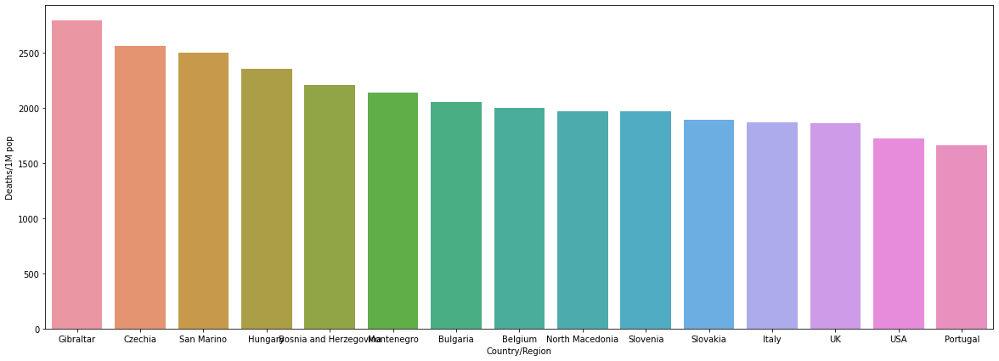

In [24]:
# Show top 15 countries of "Deaths/1M pop"

plt.figure(figsize=(20, 7))
sns.barplot(x = 'Country/Region', y = "Deaths/1M pop", data = top10d_1m);

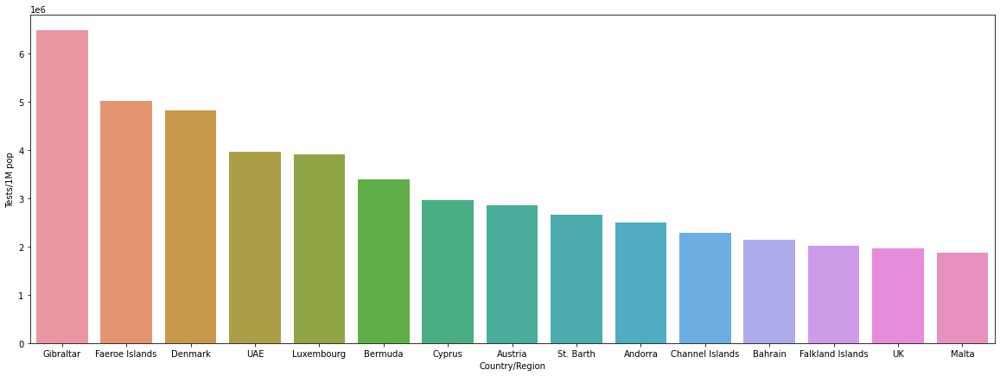

In [25]:
# Show top 15 countries of "Tests/1M pop"

plt.figure(figsize=(20, 7))
sns.barplot(x = 'Country/Region', y = "Tests/1M pop", data = top10t_1m);

In [26]:
# Slovakia

slovakia = worldometer[worldometer['Country/Region']=='Slovakia']
slovakia

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
42,Slovakia,Europe,5461679.0,368470,1576.0,10322.0,79.0,255300.0,NaN,102848.0,576.0,67465.0,1890.0,2411744.0,441576.0,Europe


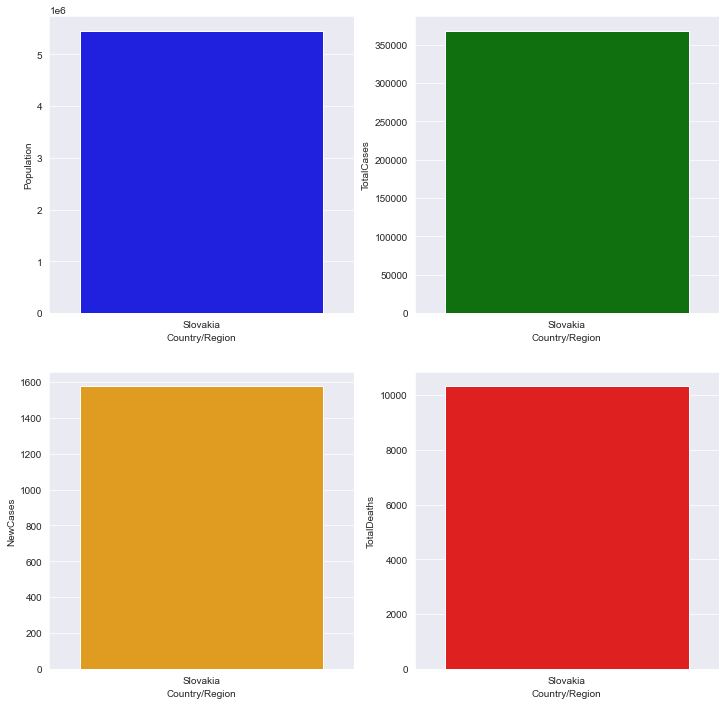

In [27]:
# Show Slovakia

sns.set_style('darkgrid')
f, axes = plt.subplots(2, 2, figsize = (12,12))
a_1 = sns.barplot (data=slovakia, x = 'Country/Region', y = 'Population', ax =axes[0,0], color = "blue")
a_2 = sns.barplot (data=slovakia, x = 'Country/Region', y = 'TotalCases', ax =axes[0,1], color = "green")
a_3 = sns.barplot (data=slovakia, x = 'Country/Region', y = 'NewCases', ax =axes[1,0], color = "orange")
b_1 = sns.barplot (data=slovakia, x = 'Country/Region', y = 'TotalDeaths', ax =axes[1,1], color = "red")
plt.show()


In [28]:
# USA

usa = worldometer[worldometer['Country/Region']=='USA']
usa

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
0,USA,North America,332494997.0,31714336,77093.0,573819.0,971.0,24271394.0,71701.0,6869123.0,9053.0,95383.0,1726.0,415050165.0,1248290.0,Americas
